In [10]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt
from tensorflow.keras import regularizers
import os


# os.environ["KERAS_BACKEND"] = "plaidml.keras.backend" # Only needed if using PlaidML

NUM_CLASSES = 8 # num_classes is the number of classes in datasets
CURRENT_DIR = os.getcwd()
DATASETS_DIR = 'Datasets'
EPOCHS = 12
BATCH_SIZE = 4

In [11]:
# Model without regularization technique
model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(150, 150, 3)),
    MaxPooling2D(2, 2),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D(2, 2),
    Conv2D(128, (3, 3), activation='relu'),
    MaxPooling2D(2, 2),
    Flatten(),
    Dense(512, activation='relu'),
    Dense(NUM_CLASSES, activation='softmax')
])

# Model with regularization technique
# model = Sequential([
#     Conv2D(32, (3, 3), activation='relu', input_shape=(150, 150, 3), kernel_regularizer=regularizers.l2(0.01)),
#     MaxPooling2D(2, 2),
#     Conv2D(64, (3, 3), activation='relu', kernel_regularizer=regularizers.l2(0.01)),
#     MaxPooling2D(2, 2),
#     Conv2D(128, (3, 3), activation='relu', kernel_regularizer=regularizers.l2(0.01)),
#     MaxPooling2D(2, 2),
#     Flatten(),
#     Dense(512, activation='relu', kernel_regularizer=regularizers.l2(0.01)),
#     Dense(NUM_CLASSES, activation='softmax')
# ])

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

model.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_12 (Conv2D)          (None, 148, 148, 32)      896       
                                                                 
 max_pooling2d_12 (MaxPooli  (None, 74, 74, 32)        0         
 ng2D)                                                           
                                                                 
 conv2d_13 (Conv2D)          (None, 72, 72, 64)        18496     
                                                                 
 max_pooling2d_13 (MaxPooli  (None, 36, 36, 64)        0         
 ng2D)                                                           
                                                                 
 conv2d_14 (Conv2D)          (None, 34, 34, 128)       73856     
                                                                 
 max_pooling2d_14 (MaxPooli  (None, 17, 17, 128)      

In [12]:
# train_datagen = ImageDataGenerator(rescale=1./255, shear_range=0.2, zoom_range=0.2, horizontal_flip=True) # without data augmentation
train_datagen = ImageDataGenerator(rescale=1./255, 
                                   shear_range=0.2, 
                                   zoom_range=0.2, 
                                   horizontal_flip=True,
                                   rotation_range=10,  # Random rotation up to 10 degrees
                                   width_shift_range=0.1,  # Randomly shift the width by 10%
                                   height_shift_range=0.1,  # Randomly shift the height by 10%
                                   brightness_range=[0.8, 1.2],  # Randomly adjust brightness
                                   fill_mode='nearest'  # Fill any newly created pixels after rotation or shifting
                                  ) # with data augmentation

test_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(os.path.join(CURRENT_DIR, DATASETS_DIR), 
                                                    target_size=(150, 150), 
                                                    batch_size=BATCH_SIZE, 
                                                    class_mode='categorical')
test_generator = test_datagen.flow_from_directory(os.path.join(CURRENT_DIR, DATASETS_DIR), 
                                                  target_size=(150, 150), 
                                                  batch_size=BATCH_SIZE, 
                                                  class_mode='categorical')

# Get the class indices from the generator
class_indices = train_generator.class_indices

# Reverse the dictionary to map indices to class labels
class_labels = {v: k for k, v in class_indices.items()}

# Count the number of datasets for each class
class_counts = {class_labels[i]: 0 for i in range(len(class_labels))}
for _, labels in train_generator.class_indices.items():
    class_counts[class_labels[labels]] += 1

# Print the count of datasets for each class
for class_label, count in class_counts.items():
    print(f"Class: {class_label}, Count: {count}")

print("\n=========\n")

# Count total training data
total_train_data = len(train_generator.filenames)
print("Total training data:", total_train_data)

# Count total test/validation data
total_test_data = len(test_generator.filenames)
print("Total test/validation data:", total_test_data)

Found 1590 images belonging to 8 classes.
Found 1590 images belonging to 8 classes.
Class: Avicennia alba, Count: 1
Class: Bruguiera cylindrica, Count: 1
Class: Bruguiera gymnorrhiza, Count: 1
Class: Lumnitzera littorea, Count: 1
Class: Rhizophora apiculata, Count: 1
Class: Rhizophora mucronata, Count: 1
Class: Sonneratia alba, Count: 1
Class: Xylocarpus granatum, Count: 1


Total training data: 1590
Total test/validation data: 1590


In [13]:
history = model.fit(train_generator, 
                    steps_per_epoch=len(train_generator), 
                    epochs=EPOCHS, 
                    validation_data=test_generator, 
                    validation_steps=len(test_generator))

Epoch 1/12
398/398 [==============================] - 380s 953ms/step - loss: 1.7450 - accuracy: 0.3415 - val_loss: 1.3895 - val_accuracy: 0.4742
Epoch 2/12
398/398 [==============================] - 345s 868ms/step - loss: 1.4350 - accuracy: 0.4509 - val_loss: 1.2554 - val_accuracy: 0.5415
Epoch 3/12
398/398 [==============================] - 351s 881ms/step - loss: 1.3076 - accuracy: 0.5107 - val_loss: 1.1602 - val_accuracy: 0.5283
Epoch 4/12
398/398 [==============================] - 346s 870ms/step - loss: 1.1779 - accuracy: 0.5579 - val_loss: 0.9926 - val_accuracy: 0.6038
Epoch 5/12
398/398 [==============================] - 354s 890ms/step - loss: 1.0644 - accuracy: 0.5994 - val_loss: 0.9670 - val_accuracy: 0.6553
Epoch 6/12
398/398 [==============================] - 352s 885ms/step - loss: 0.9584 - accuracy: 0.6428 - val_loss: 0.9118 - val_accuracy: 0.6516
Epoch 7/12
398/398 [==============================] - 336s 846ms/step - loss: 0.8437 - accuracy: 0.7006 - val_loss: 0.6351 -

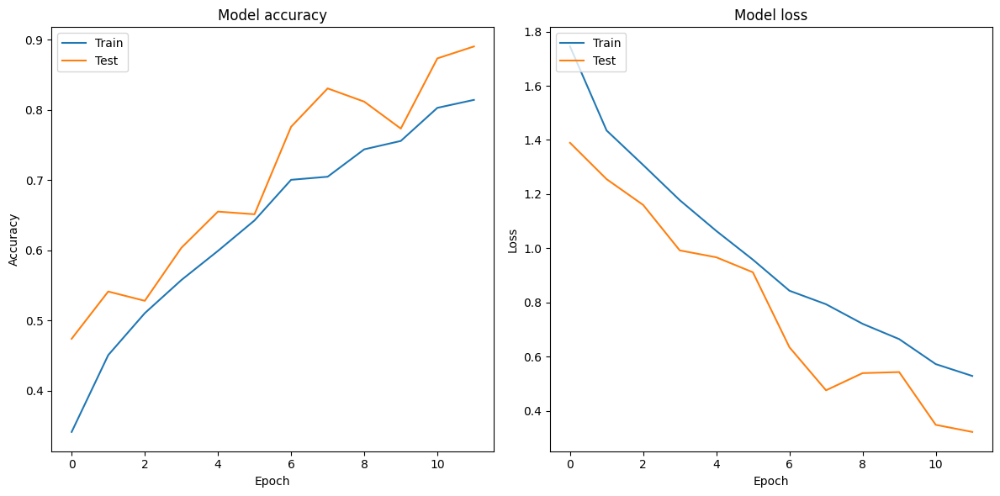

In [14]:
# Plot training & validation accuracy values
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(['Train', 'Test'], loc='upper left')

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['Train', 'Test'], loc='upper left')

plt.tight_layout()
plt.show()

In [16]:
print("Training Summary:\n\n")
for key in history.history:
    print(f"{key}:\n{history.history[key]}\n\n")

Training Summary:


loss:
[1.745022177696228, 1.4350026845932007, 1.3076021671295166, 1.1779338121414185, 1.06437349319458, 0.9583532214164734, 0.8437367081642151, 0.7938952445983887, 0.7216411232948303, 0.6651846170425415, 0.5729790329933167, 0.5291987061500549]


accuracy:
[0.3415094316005707, 0.4509434103965759, 0.5106918215751648, 0.5578616261482239, 0.599371075630188, 0.6427673101425171, 0.700628936290741, 0.7050314545631409, 0.7440251708030701, 0.7559748291969299, 0.803144633769989, 0.8144654035568237]


val_loss:
[1.389480471611023, 1.2554042339324951, 1.1602251529693604, 0.9925531148910522, 0.9670407772064209, 0.9117649793624878, 0.6350573301315308, 0.47631406784057617, 0.5397136211395264, 0.5435639023780823, 0.34890082478523254, 0.32266753911972046]


val_accuracy:
[0.4742138385772705, 0.5415094494819641, 0.5283018946647644, 0.6037735939025879, 0.6553459167480469, 0.6515723466873169, 0.7761006355285645, 0.8308176398277283, 0.8119496703147888, 0.7735849022865295, 0.873584926128

In [17]:
model.save(os.path.join(CURRENT_DIR, '202310261740.h5'))

/home/ezzy/Workspace/Developments/PITG/cnn/.venv/lib/python3.10/site-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [18]:
# Evaluate the model on the test data
test_loss, test_accuracy = model.evaluate(test_generator, steps=len(test_generator))

# Print the test loss and accuracy
print("Test Loss:", test_loss)
print("Test Accuracy:", test_accuracy)

398/398 [==============================] - 151s 380ms/step - loss: 0.3227 - accuracy: 0.8906
Test Loss: 0.3226677179336548
Test Accuracy: 0.8905660510063171


In [21]:
from sklearn.metrics import confusion_matrix, classification_report

# Get the predictions for the test data
y_pred = model.predict(test_generator)
y_pred_classes = np.argmax(y_pred, axis=1)

# Get the true labels for the test data
y_true = test_generator.classes

# Calculate the confusion matrix
cm = confusion_matrix(y_true, y_pred_classes)
print("Confusion Matrix:")
print(cm)

# Calculate precision, recall, and F1 score
report = classification_report(y_true, y_pred_classes)
print("Classification Report:")
print(report)

398/398 [==============================] - 150s 375ms/step
Confusion Matrix:
[[ 77  21 110  65  21  44  29  18]
 [ 10   1  17  11   3   4   3   3]
 [ 96  17 109  79  25  46  29  26]
 [ 47   7  56  31   8  31  10  11]
 [ 29   8  52  22   5  15   4   8]
 [ 38  11  56  32  10  20  14  10]
 [ 23   5  31  12   5  15   5   4]
 [ 16   5  20  23   8  13   4   2]]
Classification Report:
              precision    recall  f1-score   support

           0       0.23      0.20      0.21       385
           1       0.01      0.02      0.02        52
           2       0.24      0.26      0.25       427
           3       0.11      0.15      0.13       201
           4       0.06      0.03      0.04       143
           5       0.11      0.10      0.11       191
           6       0.05      0.05      0.05       100
           7       0.02      0.02      0.02        91

    accuracy                           0.16      1590
   macro avg       0.10      0.11      0.10      1590
weighted avg       0.16

In [23]:
import os
from tensorflow.keras.preprocessing import image
import numpy as np

# Define the path to the folder containing the class folders
data_dir = "TestsData"

# Get the list of class folders
class_folders = os.listdir(data_dir)

# Iterate over each class folder
for class_folder in class_folders:
    # Get the path to the current class folder
    class_folder_path = os.path.join(data_dir, class_folder)
    print("\n\n=================\n")
    print(class_folder)
    print("\n")
    
    # Get the list of image files in the class folder
    image_files = os.listdir(class_folder_path)
    
    # Iterate over each image file
    for image_file in image_files:
        # Get the path to the current image file
        image_path = os.path.join(class_folder_path, image_file)
        
        # Load and preprocess the image
        img = image.load_img(image_path, target_size=(150, 150))
        x = image.img_to_array(img)
        x = np.expand_dims(x, axis=0)
        x = x / 255.0
        
        # Make predictions
        predictions = model.predict(x)
        
        # Get the predicted class index
        predicted_class_idx = np.argmax(predictions, axis=1)
        
        # Get the class labels from the generator
        class_labels = train_generator.class_indices
        
        # Get the class name corresponding to the predicted class index
        predicted_class_name = [k for k, v in class_labels.items() if v == predicted_class_idx]
        
        # Print the predicted class name
        print(f"The predicted class for {image_file} is: {predicted_class_name}")




Xylocarpus granatum


1/1 [==============================] - 0s 23ms/step
The predicted class for PA090338.JPG is: ['Bruguiera gymnorrhiza']
1/1 [==============================] - 0s 24ms/step
The predicted class for PA090380.JPG is: ['Xylocarpus granatum']
1/1 [==============================] - 0s 22ms/step
The predicted class for IMG_8153.JPG is: ['Xylocarpus granatum']
1/1 [==============================] - 0s 23ms/step
The predicted class for PA090379.JPG is: ['Xylocarpus granatum']
1/1 [==============================] - 0s 22ms/step
The predicted class for IMG_8154.JPG is: ['Xylocarpus granatum']
1/1 [==============================] - 0s 24ms/step
The predicted class for PA090340.JPG is: ['Xylocarpus granatum']
1/1 [==============================] - 0s 23ms/step
The predicted class for PA090378.JPG is: ['Xylocarpus granatum']
1/1 [==============================] - 0s 24ms/step
The predicted class for PA090339.JPG is: ['Bruguiera gymnorrhiza']
1/1 [==============================




Xylocarpus granatum


1/1 [==============================] - 0s 25ms/step
The predicted class for PA090338.JPG is: ['Bruguiera gymnorrhiza']


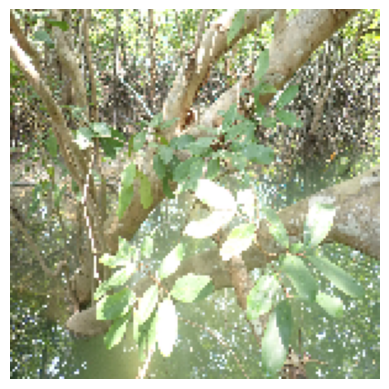

1/1 [==============================] - 0s 25ms/step
The predicted class for PA090380.JPG is: ['Xylocarpus granatum']


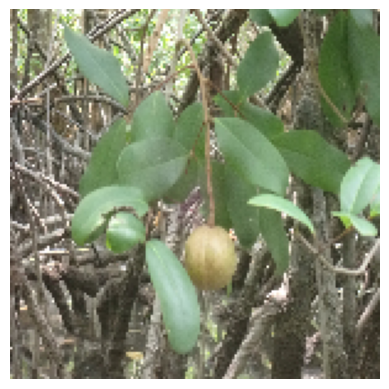

1/1 [==============================] - 0s 23ms/step
The predicted class for IMG_8153.JPG is: ['Xylocarpus granatum']


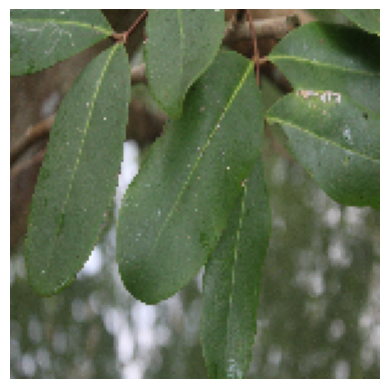

1/1 [==============================] - 0s 24ms/step
The predicted class for PA090379.JPG is: ['Xylocarpus granatum']


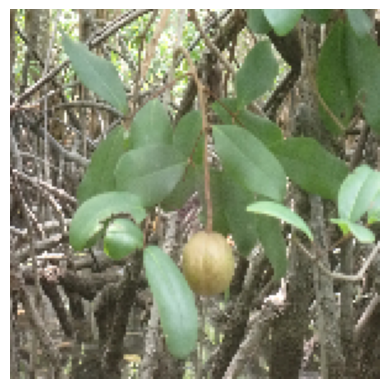

1/1 [==============================] - 0s 25ms/step
The predicted class for IMG_8154.JPG is: ['Xylocarpus granatum']


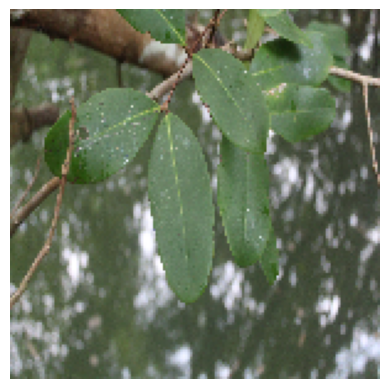

1/1 [==============================] - 0s 24ms/step
The predicted class for PA090340.JPG is: ['Xylocarpus granatum']


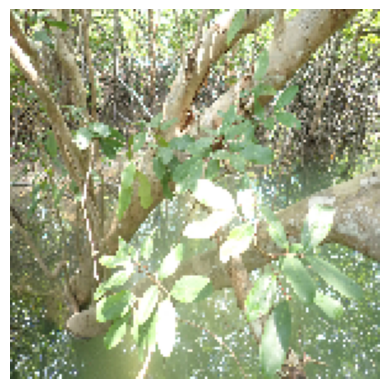

1/1 [==============================] - 0s 24ms/step
The predicted class for PA090378.JPG is: ['Xylocarpus granatum']


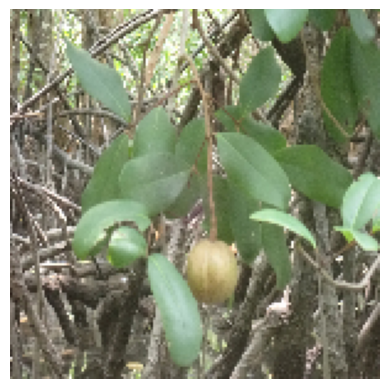

1/1 [==============================] - 0s 23ms/step
The predicted class for PA090339.JPG is: ['Bruguiera gymnorrhiza']


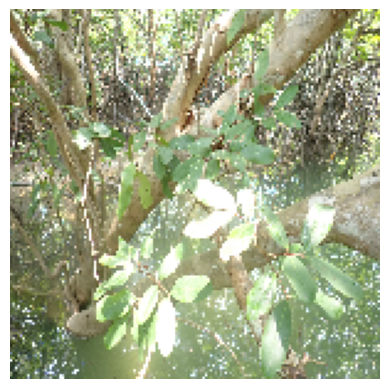

1/1 [==============================] - 0s 22ms/step
The predicted class for PA090343.JPG is: ['Bruguiera gymnorrhiza']


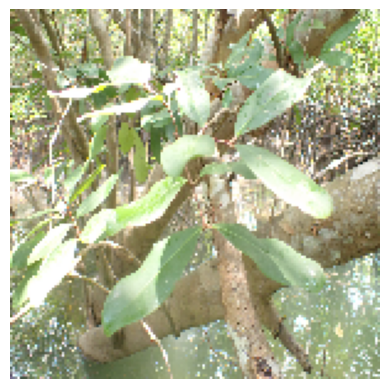

1/1 [==============================] - 0s 24ms/step
The predicted class for PA090381.JPG is: ['Xylocarpus granatum']


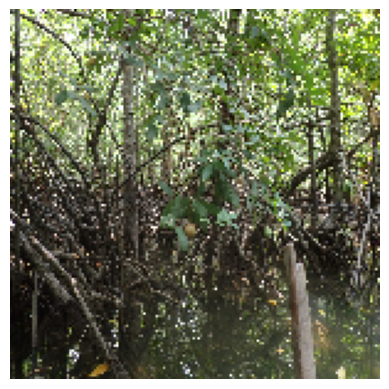




Lumnitzera littorea


1/1 [==============================] - 0s 23ms/step
The predicted class for PA150461.JPG is: ['Lumnitzera littorea']


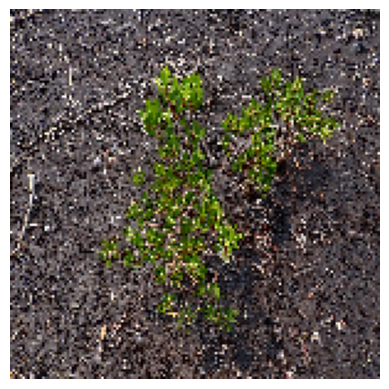

1/1 [==============================] - 0s 23ms/step
The predicted class for IMG_8336.JPG is: ['Lumnitzera littorea']


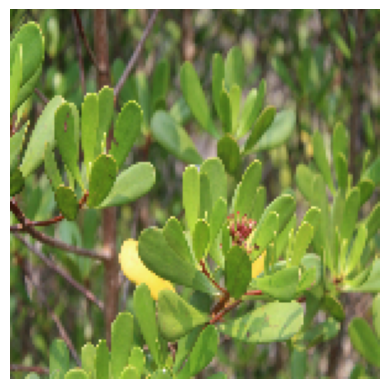

1/1 [==============================] - 0s 22ms/step
The predicted class for IMG_8335.JPG is: ['Lumnitzera littorea']


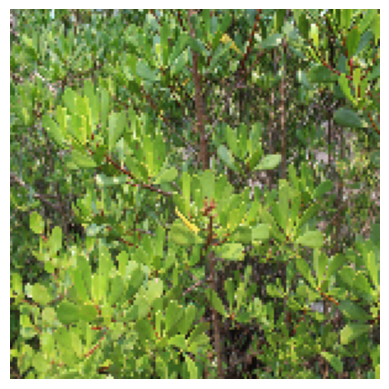

1/1 [==============================] - 0s 23ms/step
The predicted class for IMG_8279.JPG is: ['Lumnitzera littorea']


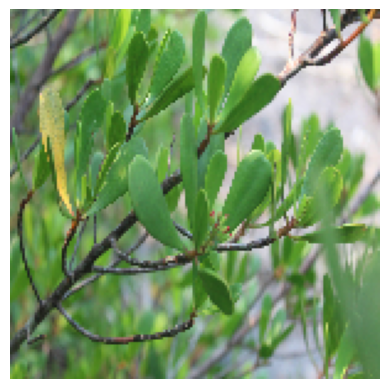

1/1 [==============================] - 0s 24ms/step
The predicted class for IMG_8277.JPG is: ['Lumnitzera littorea']


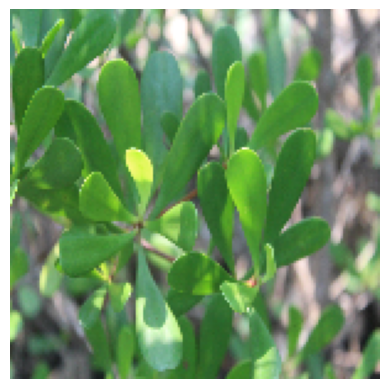

1/1 [==============================] - 0s 24ms/step
The predicted class for IMG_8280.JPG is: ['Lumnitzera littorea']


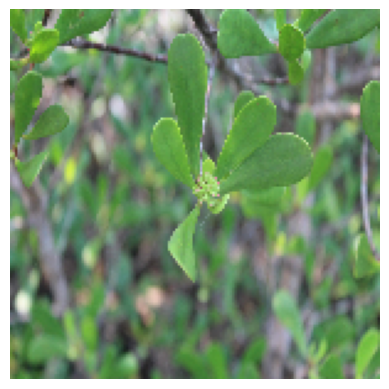

1/1 [==============================] - 0s 24ms/step
The predicted class for IMG_8276.JPG is: ['Lumnitzera littorea']


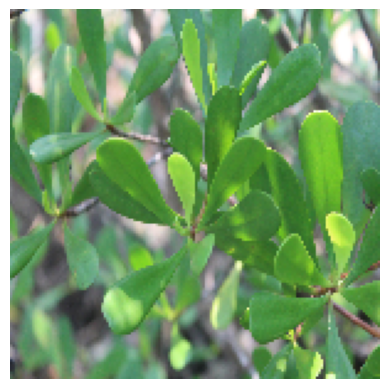

1/1 [==============================] - 0s 24ms/step
The predicted class for IMG_8278.JPG is: ['Lumnitzera littorea']


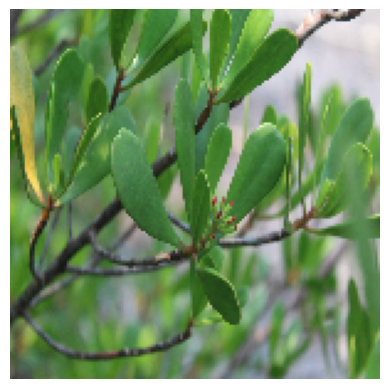

1/1 [==============================] - 0s 23ms/step
The predicted class for PA150457.JPG is: ['Lumnitzera littorea']


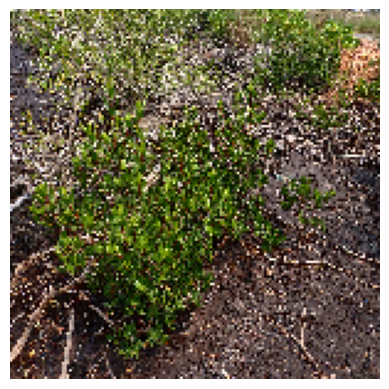

1/1 [==============================] - 0s 23ms/step
The predicted class for PA150456.JPG is: ['Lumnitzera littorea']


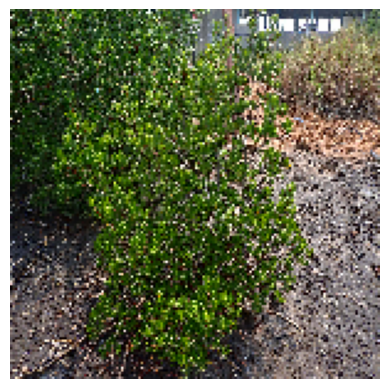




Bruguiera gymnorrhiza


1/1 [==============================] - 0s 22ms/step
The predicted class for IMG_7945.JPG is: ['Bruguiera gymnorrhiza']


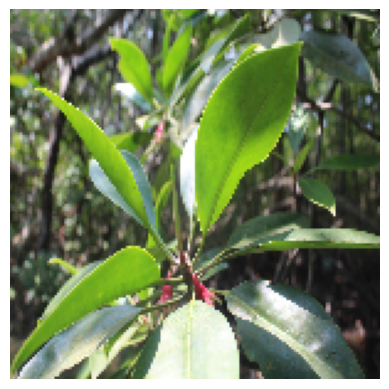

1/1 [==============================] - 0s 24ms/step
The predicted class for IMG_7938.JPG is: ['Bruguiera gymnorrhiza']


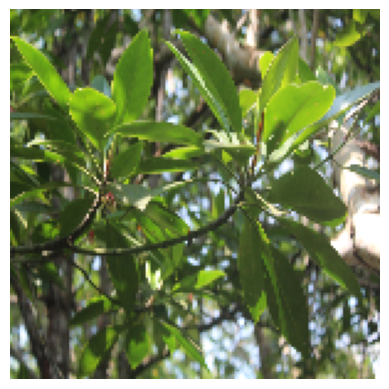

1/1 [==============================] - 0s 24ms/step
The predicted class for IMG_7948.JPG is: ['Bruguiera gymnorrhiza']


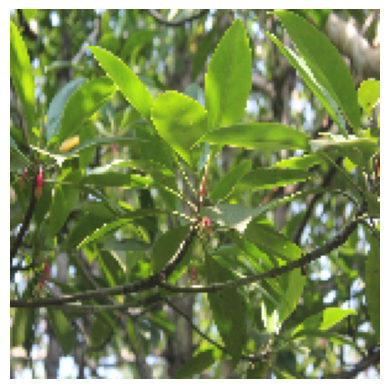

1/1 [==============================] - 0s 23ms/step
The predicted class for PA090278.JPG is: ['Bruguiera gymnorrhiza']


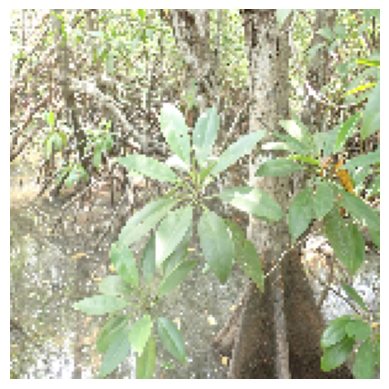

1/1 [==============================] - 0s 24ms/step
The predicted class for IMG_8009.JPG is: ['Bruguiera gymnorrhiza']


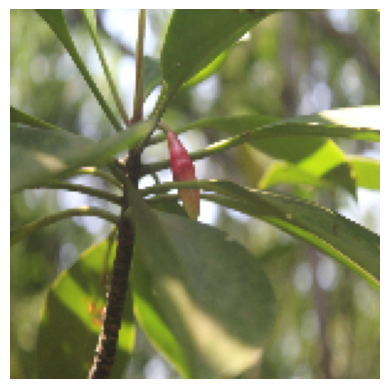

1/1 [==============================] - 0s 23ms/step
The predicted class for IMG_7930.JPG is: ['Bruguiera gymnorrhiza']


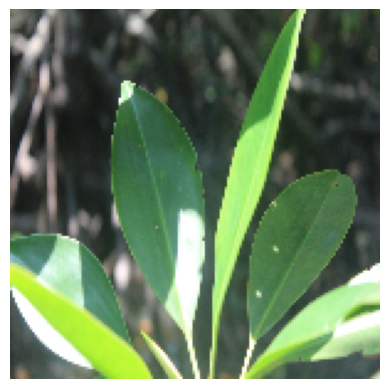

1/1 [==============================] - 0s 22ms/step
The predicted class for IMG_7934.JPG is: ['Bruguiera gymnorrhiza']


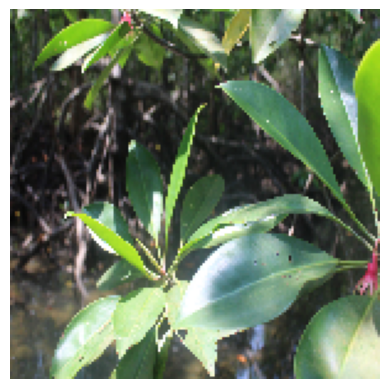

1/1 [==============================] - 0s 23ms/step
The predicted class for IMG_7896.JPG is: ['Bruguiera gymnorrhiza']


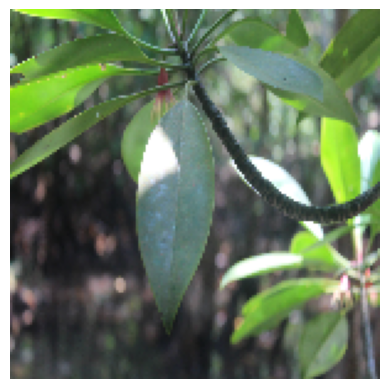

1/1 [==============================] - 0s 23ms/step
The predicted class for PA090174.JPG is: ['Bruguiera gymnorrhiza']


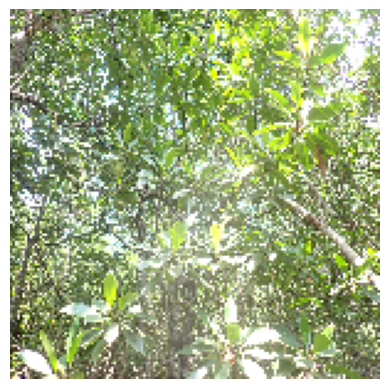

1/1 [==============================] - 0s 23ms/step
The predicted class for IMG_7952.JPG is: ['Bruguiera gymnorrhiza']


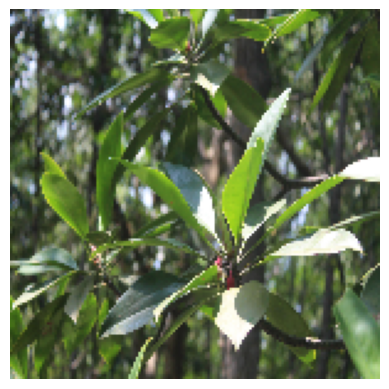




Sonneratia alba


1/1 [==============================] - 0s 27ms/step
The predicted class for PA080486.JPG is: ['Sonneratia alba']


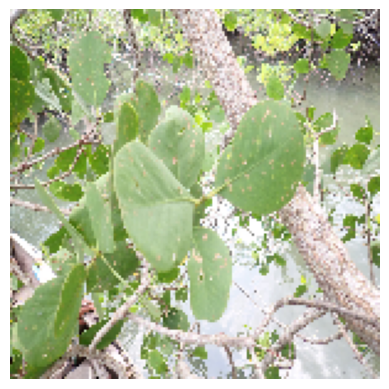

1/1 [==============================] - 0s 24ms/step
The predicted class for IMG_7663.JPG is: ['Bruguiera gymnorrhiza']


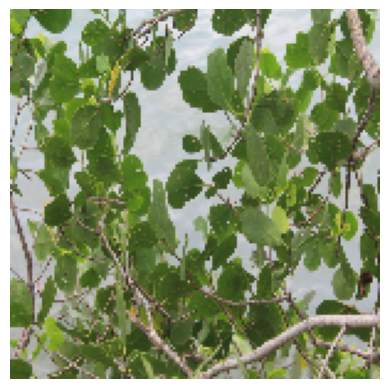

1/1 [==============================] - 0s 23ms/step
The predicted class for PA080585.JPG is: ['Sonneratia alba']


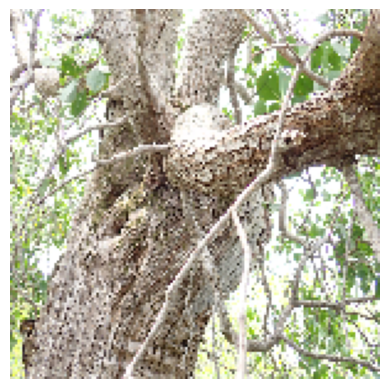

1/1 [==============================] - 0s 25ms/step
The predicted class for PA080519.JPG is: ['Sonneratia alba']


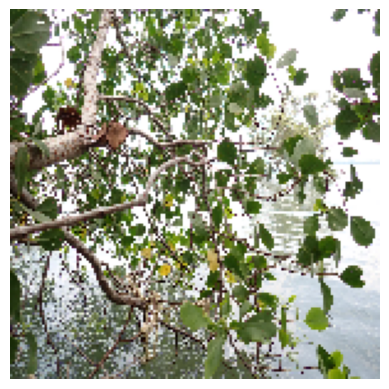

1/1 [==============================] - 0s 23ms/step
The predicted class for IMG_7664.JPG is: ['Sonneratia alba']


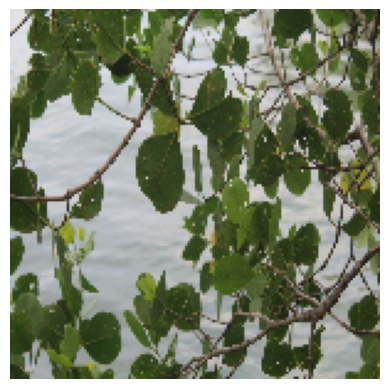

1/1 [==============================] - 0s 24ms/step
The predicted class for PA080579.JPG is: ['Sonneratia alba']


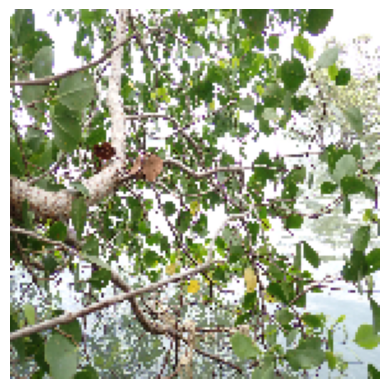

1/1 [==============================] - 0s 25ms/step
The predicted class for PA080581.JPG is: ['Sonneratia alba']


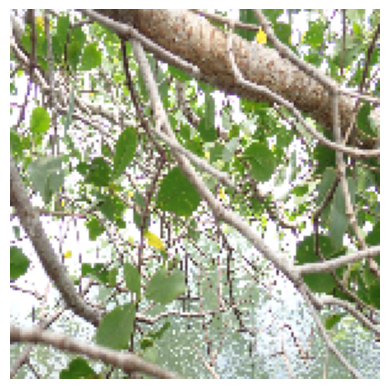

1/1 [==============================] - 0s 24ms/step
The predicted class for IMG_7668.JPG is: ['Lumnitzera littorea']


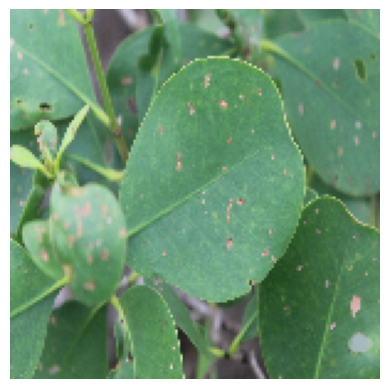

1/1 [==============================] - 0s 23ms/step
The predicted class for PA080580.JPG is: ['Sonneratia alba']


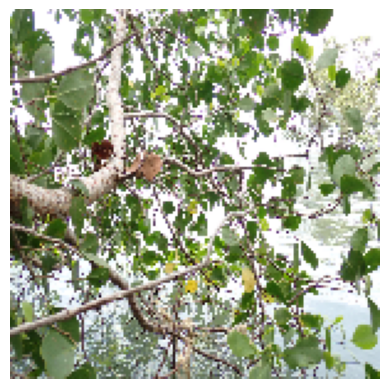

1/1 [==============================] - 0s 27ms/step
The predicted class for PA080577.JPG is: ['Sonneratia alba']


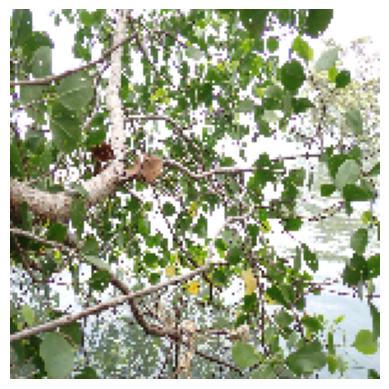




Bruguiera cylindrica


1/1 [==============================] - 0s 25ms/step
The predicted class for IMG_8517.JPG is: ['Bruguiera cylindrica']


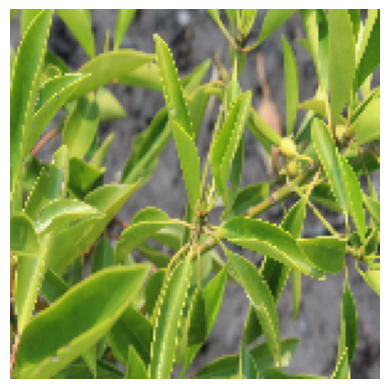

1/1 [==============================] - 0s 24ms/step
The predicted class for IMG_8568.JPG is: ['Bruguiera cylindrica']


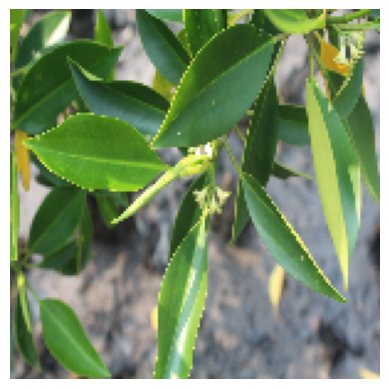

1/1 [==============================] - 0s 25ms/step
The predicted class for IMG_8567.JPG is: ['Bruguiera cylindrica']


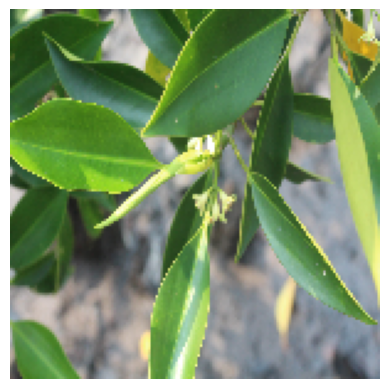

1/1 [==============================] - 0s 25ms/step
The predicted class for IMG_8565.JPG is: ['Bruguiera cylindrica']


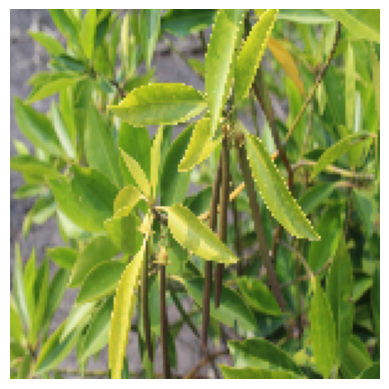

1/1 [==============================] - 0s 25ms/step
The predicted class for IMG_8555.JPG is: ['Lumnitzera littorea']


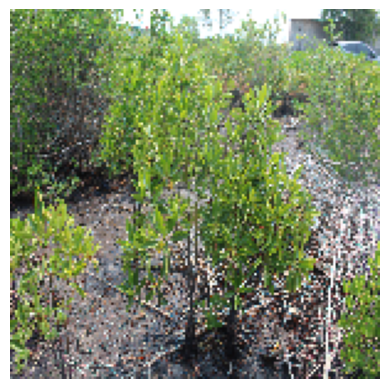

1/1 [==============================] - 0s 24ms/step
The predicted class for IMG_8523.JPG is: ['Bruguiera cylindrica']


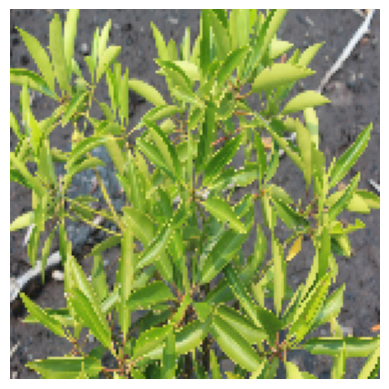

1/1 [==============================] - 0s 26ms/step
The predicted class for IMG_8520.JPG is: ['Bruguiera cylindrica']


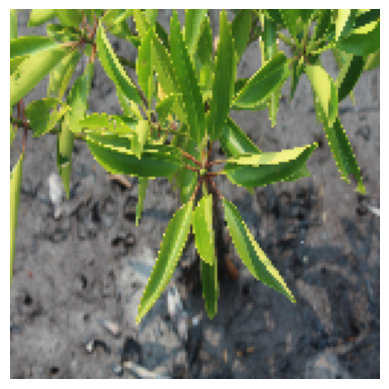

1/1 [==============================] - 0s 26ms/step
The predicted class for IMG_8553.JPG is: ['Bruguiera cylindrica']


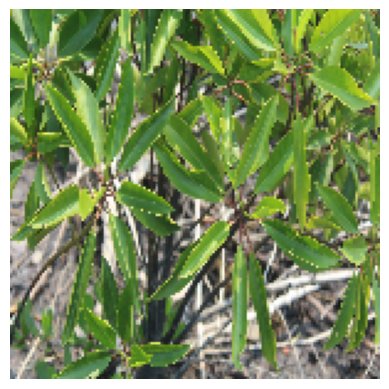

1/1 [==============================] - 0s 24ms/step
The predicted class for IMG_8519.JPG is: ['Bruguiera cylindrica']


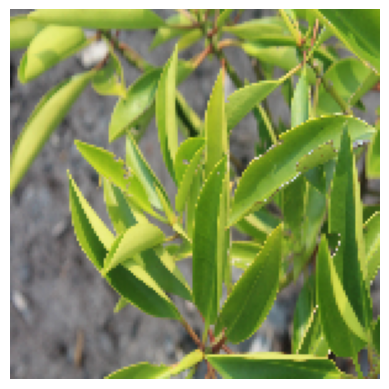

1/1 [==============================] - 0s 24ms/step
The predicted class for IMG_8554.JPG is: ['Bruguiera cylindrica']


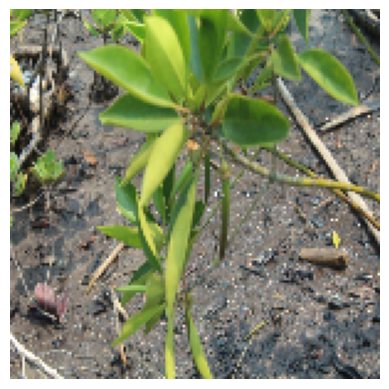




Avicennia alba


1/1 [==============================] - 0s 26ms/step
The predicted class for PA080269.JPG is: ['Avicennia alba']


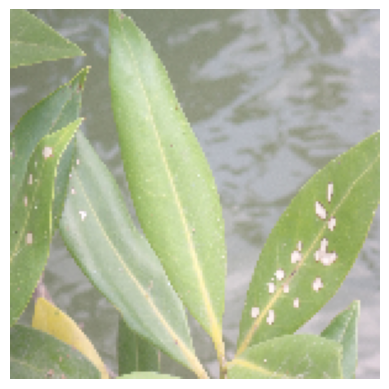

1/1 [==============================] - 0s 24ms/step
The predicted class for PA080317.JPG is: ['Avicennia alba']


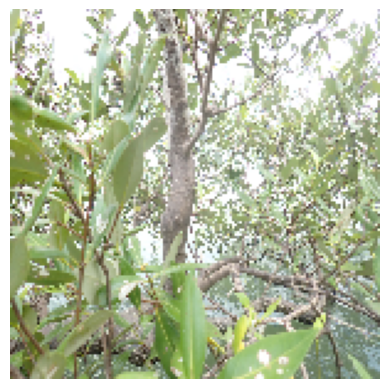

1/1 [==============================] - 0s 25ms/step
The predicted class for PA080404.JPG is: ['Avicennia alba']


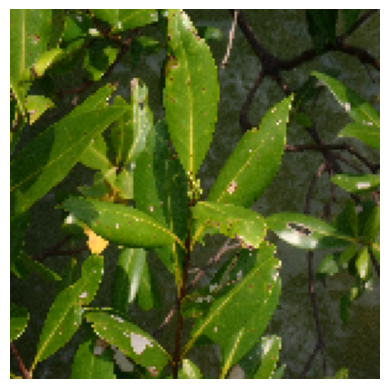

1/1 [==============================] - 0s 24ms/step
The predicted class for PA080201.JPG is: ['Avicennia alba']


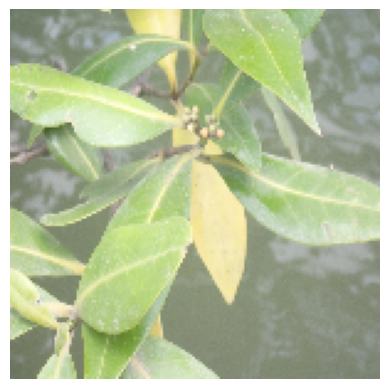

1/1 [==============================] - 0s 23ms/step
The predicted class for PA080382.JPG is: ['Avicennia alba']


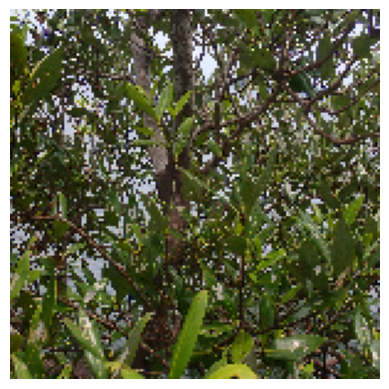

1/1 [==============================] - 0s 24ms/step
The predicted class for PA080483.JPG is: ['Avicennia alba']


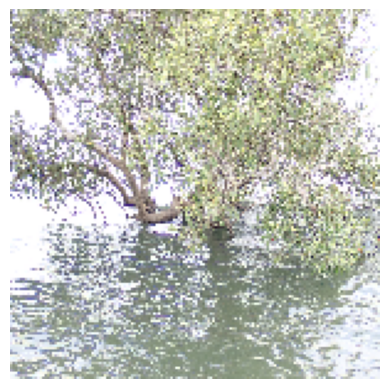

1/1 [==============================] - 0s 23ms/step
The predicted class for PA080423.JPG is: ['Bruguiera cylindrica']


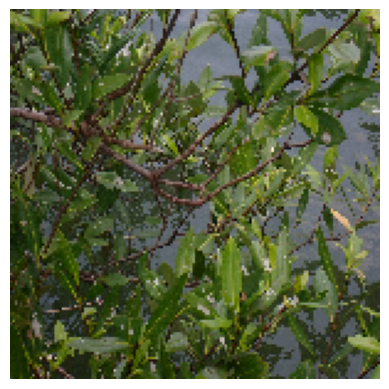

1/1 [==============================] - 0s 24ms/step
The predicted class for PA080365.JPG is: ['Rhizophora apiculata']


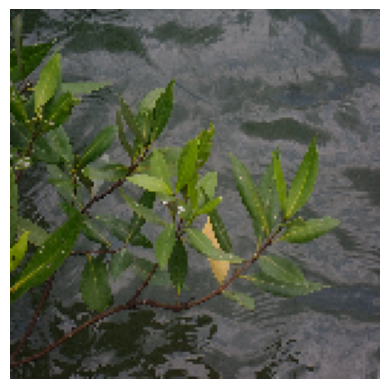

1/1 [==============================] - 0s 22ms/step
The predicted class for PA080447.JPG is: ['Avicennia alba']


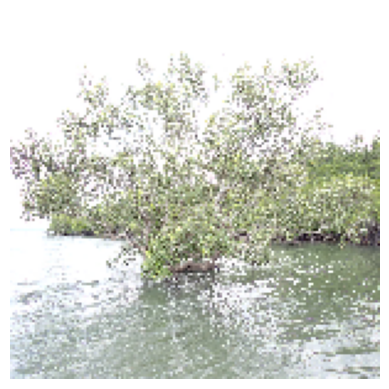

1/1 [==============================] - 0s 24ms/step
The predicted class for PA080313.JPG is: ['Avicennia alba']


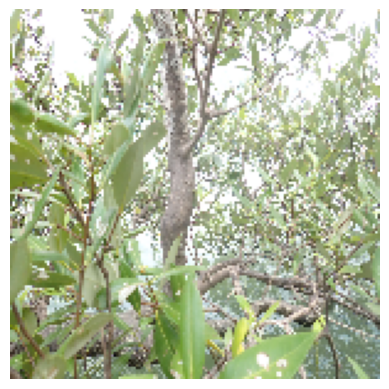




Rhizophora mucronata


1/1 [==============================] - 0s 22ms/step
The predicted class for PA080194.JPG is: ['Rhizophora mucronata']


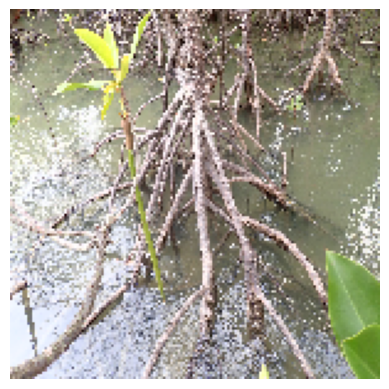

1/1 [==============================] - 0s 23ms/step
The predicted class for PA080091.JPG is: ['Rhizophora mucronata']


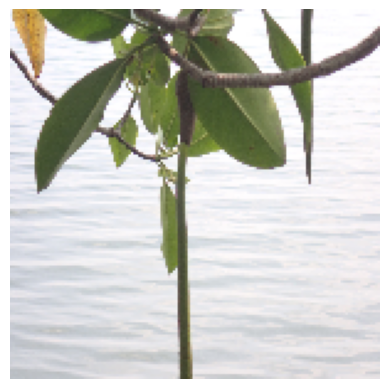

1/1 [==============================] - 0s 22ms/step
The predicted class for PA080090.JPG is: ['Rhizophora mucronata']


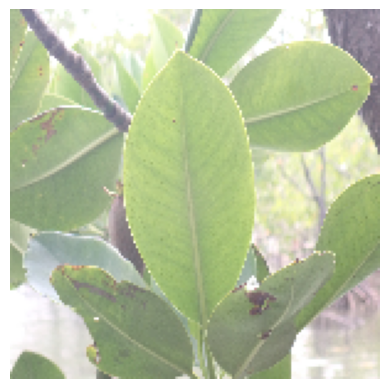

1/1 [==============================] - 0s 22ms/step
The predicted class for PA080088.JPG is: ['Rhizophora mucronata']


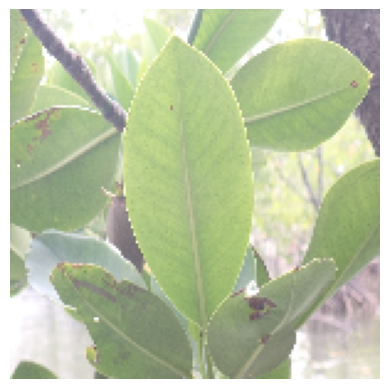

1/1 [==============================] - 0s 23ms/step
The predicted class for PA080153.JPG is: ['Rhizophora mucronata']


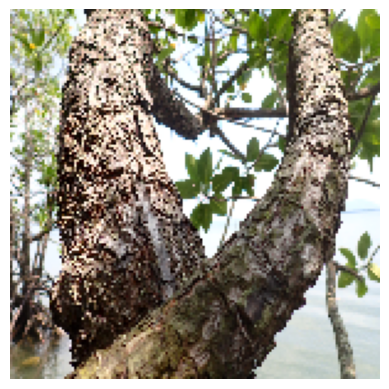

1/1 [==============================] - 0s 26ms/step
The predicted class for PA080089.JPG is: ['Rhizophora mucronata']


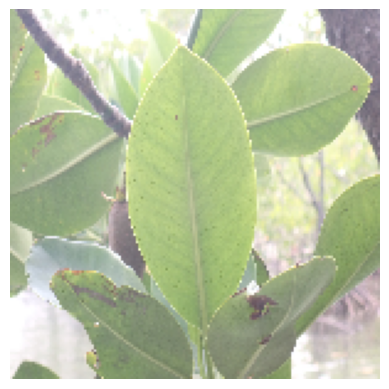

1/1 [==============================] - 0s 25ms/step
The predicted class for PA080191.JPG is: ['Rhizophora mucronata']


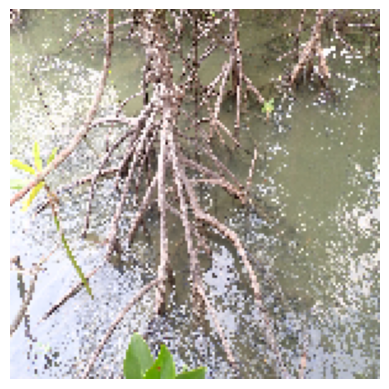

1/1 [==============================] - 0s 25ms/step
The predicted class for PA080192.JPG is: ['Rhizophora mucronata']


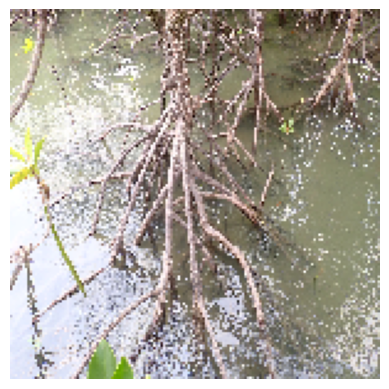

1/1 [==============================] - 0s 23ms/step
The predicted class for PA080195.JPG is: ['Rhizophora mucronata']


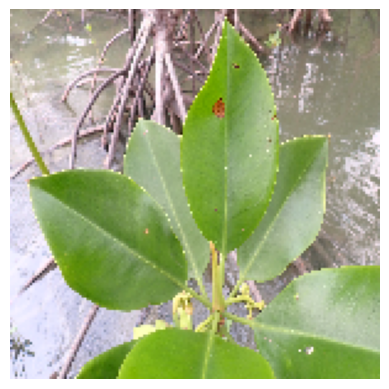

1/1 [==============================] - 0s 22ms/step
The predicted class for PA080092.JPG is: ['Bruguiera gymnorrhiza']


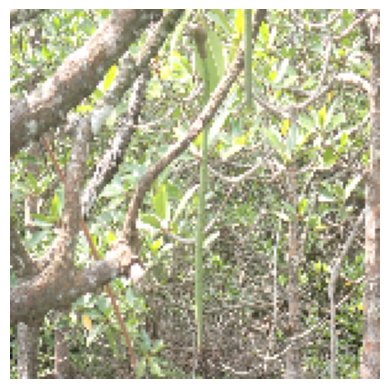




Rhizophora apiculata


1/1 [==============================] - 0s 24ms/step
The predicted class for IMG_7852.JPG is: ['Rhizophora apiculata']


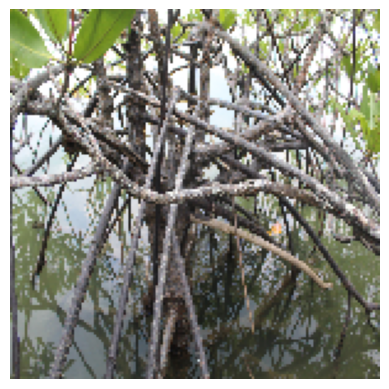

1/1 [==============================] - 0s 23ms/step
The predicted class for IMG_7854.JPG is: ['Avicennia alba']


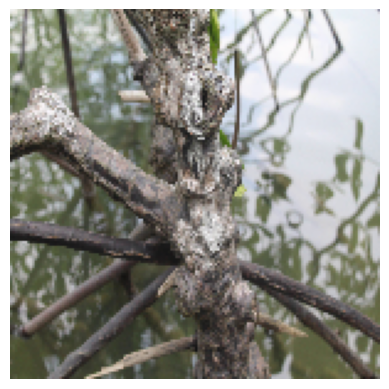

1/1 [==============================] - 0s 25ms/step
The predicted class for IMG_7851.JPG is: ['Rhizophora apiculata']


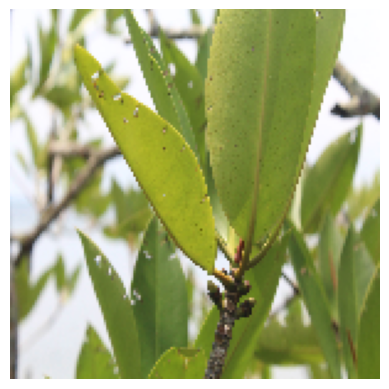

1/1 [==============================] - 0s 25ms/step
The predicted class for IMG_7813.JPG is: ['Rhizophora apiculata']


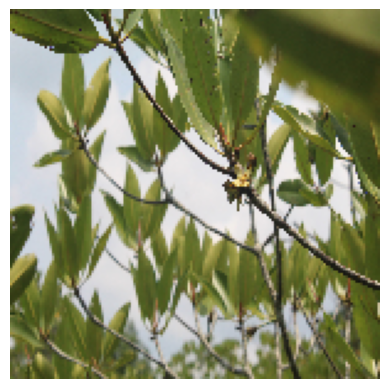

1/1 [==============================] - 0s 22ms/step
The predicted class for IMG_7815.JPG is: ['Rhizophora apiculata']


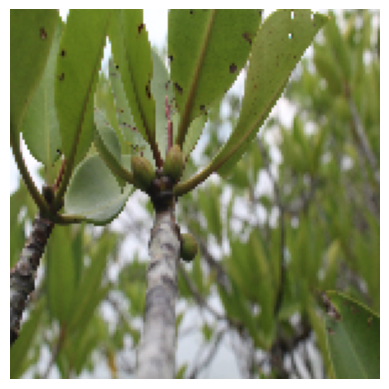

1/1 [==============================] - 0s 24ms/step
The predicted class for IMG_7855.JPG is: ['Rhizophora apiculata']


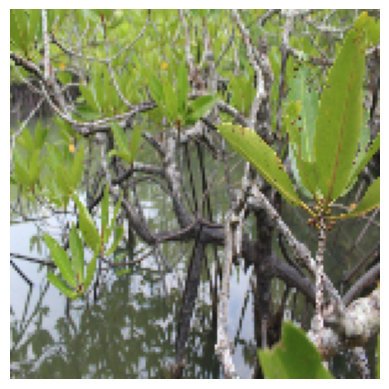

1/1 [==============================] - 0s 22ms/step
The predicted class for IMG_7812.JPG is: ['Rhizophora apiculata']


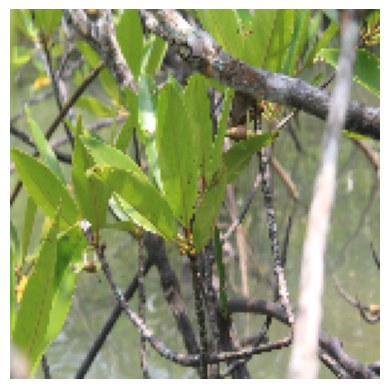

1/1 [==============================] - 0s 26ms/step
The predicted class for IMG_7814.JPG is: ['Lumnitzera littorea']


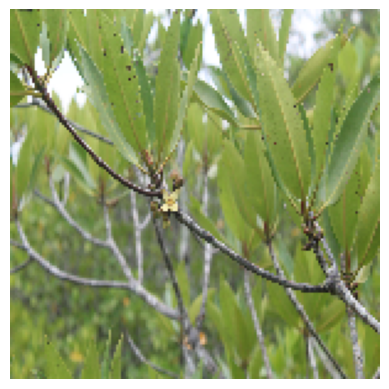

1/1 [==============================] - 0s 24ms/step
The predicted class for IMG_7859.JPG is: ['Rhizophora apiculata']


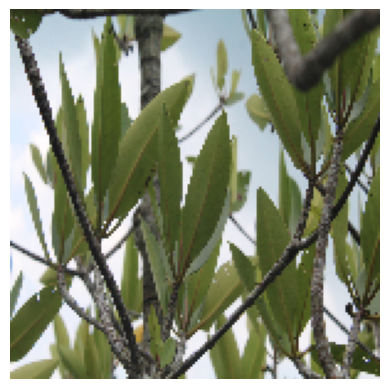

1/1 [==============================] - 0s 33ms/step
The predicted class for IMG_7853.JPG is: ['Rhizophora mucronata']


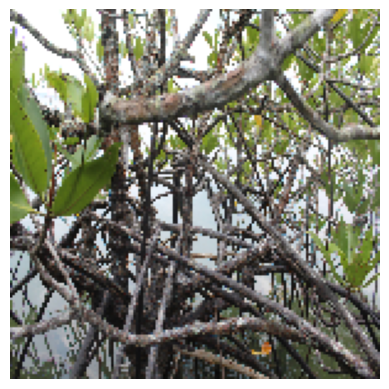

In [24]:
import os
from tensorflow.keras.preprocessing import image
import numpy as np
import matplotlib.pyplot as plt

# Define the path to the folder containing the class folders
data_dir = "TestsData"

# Get the list of class folders
class_folders = os.listdir(data_dir)

# Iterate over each class folder
for class_folder in class_folders:
    # Get the path to the current class folder
    class_folder_path = os.path.join(data_dir, class_folder)
    print("\n\n=================\n")
    print(class_folder)
    print("\n")
    
    # Get the list of image files in the class folder
    image_files = os.listdir(class_folder_path)
    
    # Iterate over each image file
    for image_file in image_files:
        # Get the path to the current image file
        image_path = os.path.join(class_folder_path, image_file)
        
        # Load and preprocess the image
        img = image.load_img(image_path, target_size=(150, 150))
        x = image.img_to_array(img)
        x = np.expand_dims(x, axis=0)
        x = x / 255.0
        
        # Make predictions
        predictions = model.predict(x)
        
        # Get the predicted class index
        predicted_class_idx = np.argmax(predictions, axis=1)
        
        # Get the class labels from the generator
        class_labels = train_generator.class_indices
        
        # Get the class name corresponding to the predicted class index
        predicted_class_name = [k for k, v in class_labels.items() if v == predicted_class_idx]
        
        # Print the predicted class name
        print(f"The predicted class for {image_file} is: {predicted_class_name}")
        
        # Display the image
        plt.imshow(img)
        plt.axis('off')
        plt.show()

In [25]:
class_labels

{'Avicennia alba': 0,
 'Bruguiera cylindrica': 1,
 'Bruguiera gymnorrhiza': 2,
 'Lumnitzera littorea': 3,
 'Rhizophora apiculata': 4,
 'Rhizophora mucronata': 5,
 'Sonneratia alba': 6,
 'Xylocarpus granatum': 7}